In [36]:
import torch
from torchvision.transforms import v2
from torch.utils.data import DataLoader
from src.datasets.imageio import get_X_paths, get_y_paths
from src.datasets.dataset import CloudCoverDataset
from src.datasets.transforms.minmax_normalize import MinMaxNormalize
from src.datasets.exploration.visualization import show_rgb_infrared_ground_truth, show_channels, show_stats, show_class_distribution

# Data Loading

Each x can have up to 4 different feature types, one for R, G, B, Infrared.  
Each feature is an image.  

In [37]:
train_X_paths = get_X_paths()
train_X_paths[:3]

[[PosixPath('../data/final/public/train_features/adwp/B02.tif'),
  PosixPath('../data/final/public/train_features/adwp/B03.tif'),
  PosixPath('../data/final/public/train_features/adwp/B04.tif'),
  PosixPath('../data/final/public/train_features/adwp/B08.tif')],
 [PosixPath('../data/final/public/train_features/adwu/B02.tif'),
  PosixPath('../data/final/public/train_features/adwu/B03.tif'),
  PosixPath('../data/final/public/train_features/adwu/B04.tif'),
  PosixPath('../data/final/public/train_features/adwu/B08.tif')],
 [PosixPath('../data/final/public/train_features/adwz/B02.tif'),
  PosixPath('../data/final/public/train_features/adwz/B03.tif'),
  PosixPath('../data/final/public/train_features/adwz/B04.tif'),
  PosixPath('../data/final/public/train_features/adwz/B08.tif')]]

In [38]:
train_y_paths = get_y_paths()
train_y_paths[:3]

[PosixPath('../data/final/public/train_labels/adwp.tif'),
 PosixPath('../data/final/public/train_labels/adwu.tif'),
 PosixPath('../data/final/public/train_labels/adwz.tif')]

## Create Dataset

In [61]:
train_ds = CloudCoverDataset(
    X_paths=train_X_paths, 
    y_paths=train_y_paths, 
    transforms=None
)

In [62]:
sample_size_for_analysis = 1000

In [63]:
torch.manual_seed(42)
train_dl = DataLoader(train_ds, batch_size=sample_size_for_analysis, shuffle=True)

In [64]:
X_train, y_train = next(iter(train_dl))

In [65]:
X_train.shape

torch.Size([1000, 4, 512, 512])

In [66]:
y_train.shape

torch.Size([1000, 512, 512])

In [67]:
def verify_min_max(X):
    for c in range(X.shape[1]):
        print(f'Channel {c} min: {X[:, c, :, :].min()}, max {X[:, c, :, :].max()}')

In [68]:
verify_min_max(X_train)

Channel 0 min: 0, max 22464
Channel 1 min: 0, max 20384
Channel 2 min: 0, max 19056
Channel 3 min: 0, max 17088


In [69]:
transfrmed_X_train = v2.Compose([MinMaxNormalize(0, 1)])({'image':X_train})['image']

In [70]:
verify_min_max(transfrmed_X_train)

Channel 0 min: 0.0, max 1.0
Channel 1 min: 0.0, max 1.0
Channel 2 min: 0.0, max 1.0
Channel 3 min: 0.0, max 1.0


In [71]:
transfrmed_X_train.shape

torch.Size([1000, 4, 512, 512])

# Visualize Images & Ground Truth

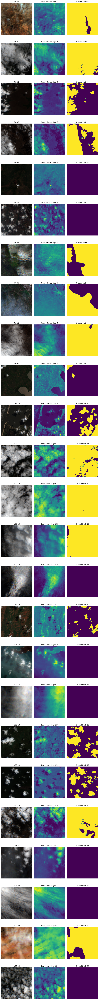

In [72]:
show_rgb_infrared_ground_truth(transfrmed_X_train, y_train, max_rows=25)

## Visualize Channels

Blue, Green, Red, Infrared

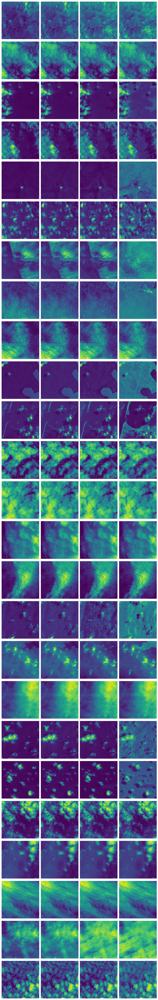

In [73]:
show_channels(transfrmed_X_train, max_rows=25)

# Visualize Stats

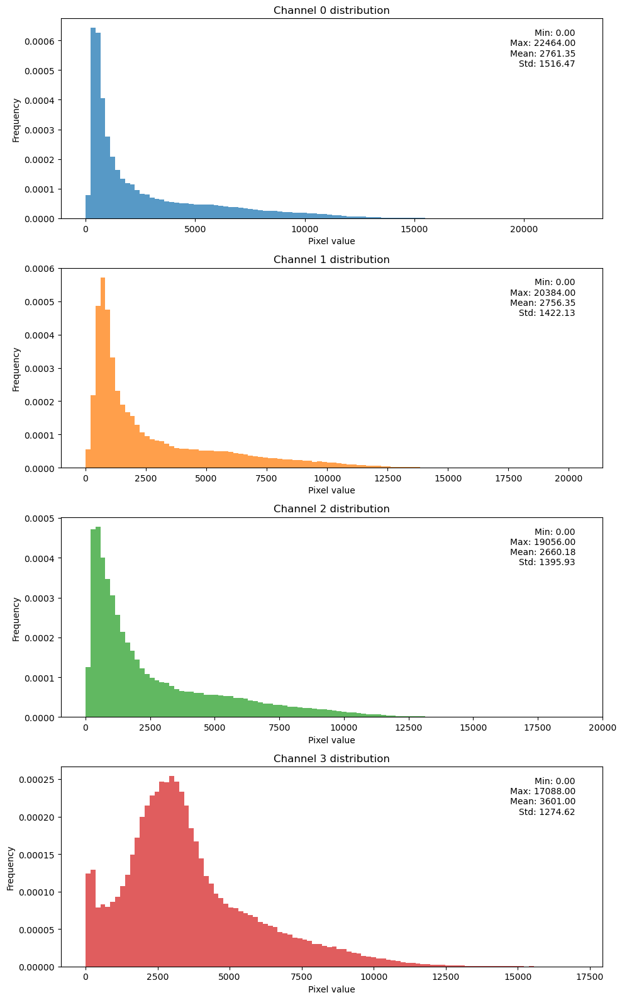

In [74]:
show_stats(X_train)

# Visualize Class Distribution

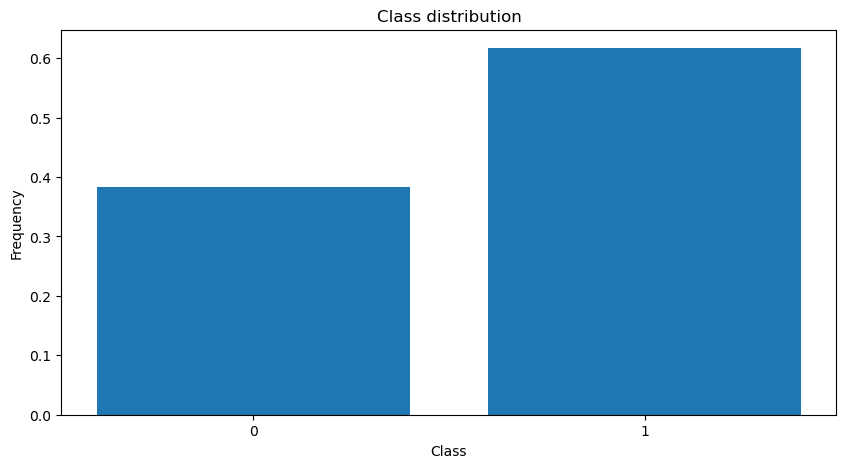

In [75]:
show_class_distribution(y_train)

# Hypothesis
- Looking at the individual channels, we can express the hypothesis that Red and Blue seem to show relatively similar information and Green sometimes shows different information, this might be due to the presence of mountains or trees which are often shown in green. 
- The infrared channel seem to have a different pixel value distribution than R,G,B and the visualization seems to suggest it provides complementary information to RGB which might be useful for the model.
## Data Observations 
- Some samples are more tricky than others, some look like clouds but are not and it is hard to know (even for us human) without more context, these cases might be challenging for the model.
- Some labels are all 0s or all 1s which might or might not cause difficulties to the model.
- The samples from the training set seem to have at least the following cases :  
  - Data that contains clouds in some parts of the image (patches of clouds)
    - <img src="https://i.ibb.co/tJs0r6V/patches-clouds.png" height="200px"/>  
  - Data that mostly contains clouds but has some parts that are not clouds (patches of NOT clouds)
    - <img src="https://i.ibb.co/P52FDQp/patches-not-clouds.png" height="200px"/>  
  - Data that looks like a close-up photo of clouds but that is not clouds (all 0s)
    - <img src="https://i.ibb.co/bW5T2KL/close-up-not-clouds.png" height="200px"/>  
    - Could be smoke, fire, snow   
  - Data that does not look like clouds and that is not clouds (all 0s)
    - <img src="https://i.ibb.co/6XRn1Rt/not-clouds.png" height="200px"/>   
  - Data that is only clouds or almost only clouds (all 1s)
    - <img src="https://i.ibb.co/n0sXcNm/only-clouds.png" height="200px"/>   
- Would be interesting to check the performance of the models on some of these cases to see if the error can be attributed to some specific cases 
- Some images seem to be taken at night time, in those instances, the infrared channel seems to capture a lot of the information that is missing from the RGB channels.
    - Maybe the time is an important feature to add to the model inputs